In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import warnings
warnings.filterwarnings('ignore')

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/water-pollution-and-disease/water_pollution_disease.csv


In [2]:
df = pd.read_csv('/kaggle/input/water-pollution-and-disease/water_pollution_disease.csv')

In [3]:
df

,Country,Region,Year,Water Source Type,Contaminant Level (ppm),pH Level,Turbidity (NTU),Dissolved Oxygen (mg/L),Nitrate Level (mg/L),Lead Concentration (µg/L),...,"Cholera Cases per 100,000 people","Typhoid Cases per 100,000 people","Infant Mortality Rate (per 1,000 live births)",GDP per Capita (USD),Healthcare Access Index (0-100),Urbanization Rate (%),Sanitation Coverage (% of Population),Rainfall (mm per year),Temperature (°C),Population Density (people per km²)
0,Mexico,North,2015,Lake,6.06,7.12,3.93,4.28,8.28,7.89,...,33,44,76.16,57057,96.92,84.61,63.23,2800,4.94,593
1,Brazil,West,2017,Well,5.24,7.84,4.79,3.86,15.74,14.68,...,27,8,77.30,17220,84.73,73.37,29.12,1572,16.93,234
2,Indonesia,Central,2022,Pond,0.24,6.43,0.79,3.42,36.67,9.96,...,39,50,48.45,86022,58.37,72.86,93.56,2074,21.73,57
3,Nigeria,East,2016,Well,7.91,6.71,1.96,3.12,36.92,6.77,...,33,13,95.66,31166,39.07,71.07,94.25,937,3.79,555
4,Mexico,South,2005,Well,0.12,8.16,4.22,9.15,49.35,12.51,...,31,68,58.78,25661,23.03,55.55,69.23,2295,31.44,414
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2995,Nigeria,East,2002,Tap,2.82,7.40,4.43,9.69,37.58,18.52,...,28,56,73.77,21255,75.34,15.22,53.06,264,31.64,882
2996,Nigeria,North,2019,Lake,8.13,8.33,4.77,7.62,38.05,16.98,...,34,34,71.11,79148,6.91,22.89,78.45,2699,33.21,67
2997,USA,South,2009,Pond,1.18,6.76,4.75,7.07,36.13,7.99,...,49,9,96.63,48569,86.17,85.89,47.38,1052,11.57,643
2998,Pakistan,South,2009,Pond,7.56,6.12,3.49,8.93,25.30,19.86,...,33,90,20.71,49099,20.50,20.78,23.34,369,14.69,643


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3000 entries, 0 to 2999
Data columns (total 24 columns):
 #   Column                                         Non-Null Count  Dtype  
---  ------                                         --------------  -----  
 0   Country                                        3000 non-null   object 
 1   Region                                         3000 non-null   object 
 2   Year                                           3000 non-null   int64  
 3   Water Source Type                              3000 non-null   object 
 4   Contaminant Level (ppm)                        3000 non-null   float64
 5   pH Level                                       3000 non-null   float64
 6   Turbidity (NTU)                                3000 non-null   float64
 7   Dissolved Oxygen (mg/L)                        3000 non-null   float64
 8   Nitrate Level (mg/L)                           3000 non-null   float64
 9   Lead Concentration (µg/L)                      3000 

In [5]:
df.columns

Index(['Country', 'Region', 'Year', 'Water Source Type',
       'Contaminant Level (ppm)', 'pH Level', 'Turbidity (NTU)',
       'Dissolved Oxygen (mg/L)', 'Nitrate Level (mg/L)',
       'Lead Concentration (µg/L)', 'Bacteria Count (CFU/mL)',
       'Water Treatment Method', 'Access to Clean Water (% of Population)',
       'Diarrheal Cases per 100,000 people',
       'Cholera Cases per 100,000 people', 'Typhoid Cases per 100,000 people',
       'Infant Mortality Rate (per 1,000 live births)', 'GDP per Capita (USD)',
       'Healthcare Access Index (0-100)', 'Urbanization Rate (%)',
       'Sanitation Coverage (% of Population)', 'Rainfall (mm per year)',
       'Temperature (°C)', 'Population Density (people per km²)'],
      dtype='object')

In [6]:
char_col = ['Country','Region', 'Water Source Type', 'Water Treatment Method']

In [7]:
df.select_dtypes(include='object')

,Country,Region,Water Source Type,Water Treatment Method
0,Mexico,North,Lake,Filtration
1,Brazil,West,Well,Boiling
2,Indonesia,Central,Pond,NaN
3,Nigeria,East,Well,Boiling
4,Mexico,South,Well,Filtration
...,...,...,...,...
2995,Nigeria,East,Tap,NaN
2996,Nigeria,North,Lake,Boiling
2997,USA,South,Pond,Boiling
2998,Pakistan,South,Pond,Boiling


In [8]:
cols = ['Country', 'Region', 'Year', 'Water Source Type',
       'Contaminant Level (ppm)', 'pH Level', 'Turbidity (NTU)',
       'Dissolved Oxygen (mg/L)', 'Nitrate Level (mg/L)',
       'Lead Concentration (µg/L)', 'Bacteria Count (CFU/mL)',
       'Water Treatment Method', 'Access to Clean Water (% of Population)',
       'Diarrheal Cases per 100,000 people',
       'Cholera Cases per 100,000 people', 'Typhoid Cases per 100,000 people',
       'Infant Mortality Rate (per 1,000 live births)', 'GDP per Capita (USD)',
       'Healthcare Access Index (0-100)', 'Urbanization Rate (%)',
       'Sanitation Coverage (% of Population)', 'Rainfall (mm per year)',
       'Temperature (°C)', 'Population Density (people per km²)']

# DATA VIZUALIZATION

In [9]:
import matplotlib.pyplot as plt
import seaborn as sns

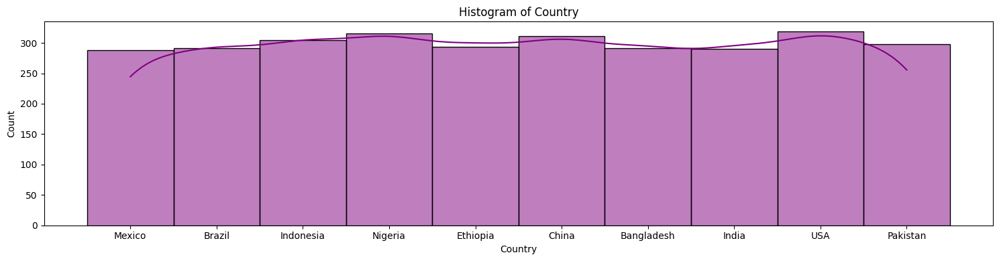

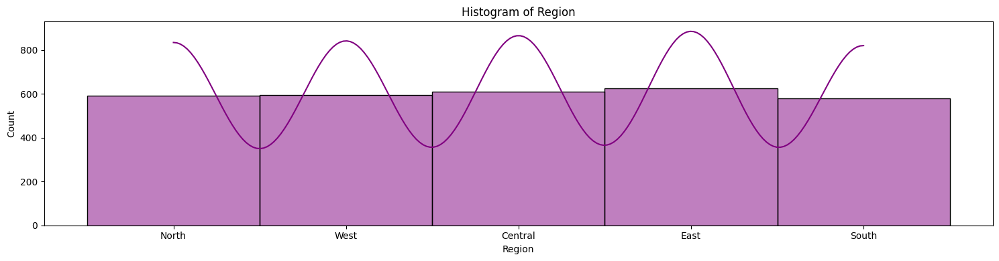

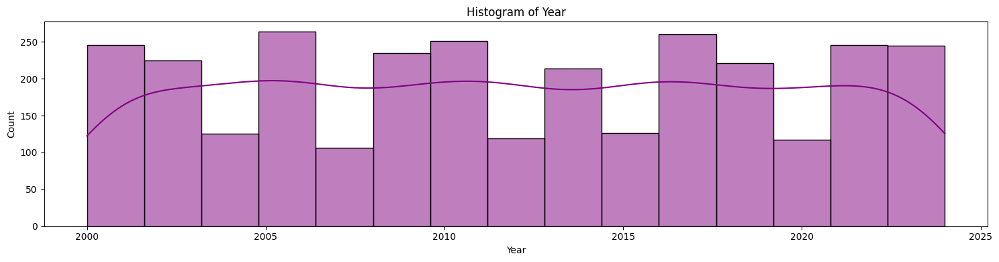

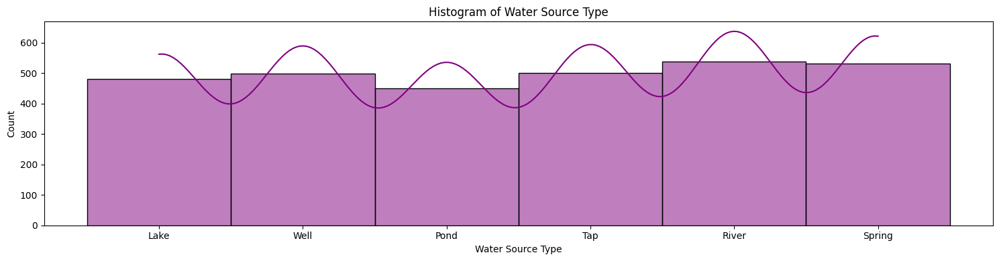

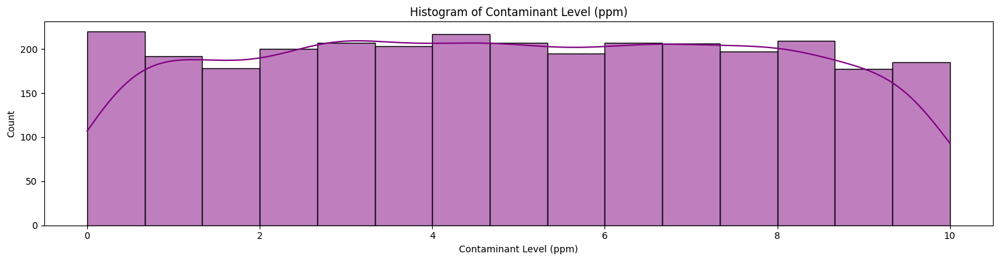

...

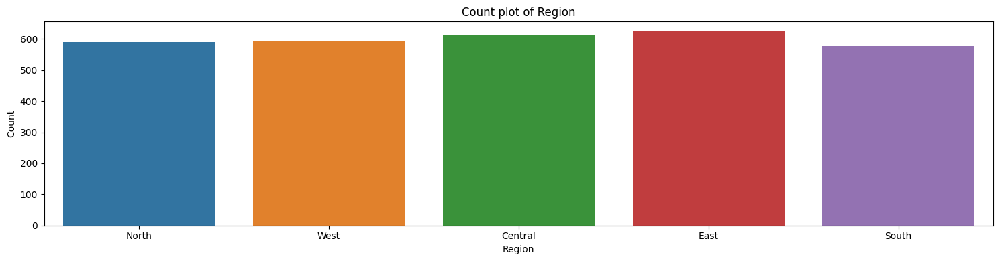

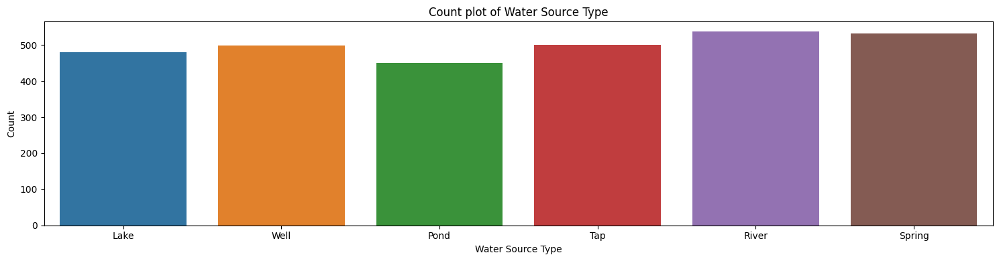

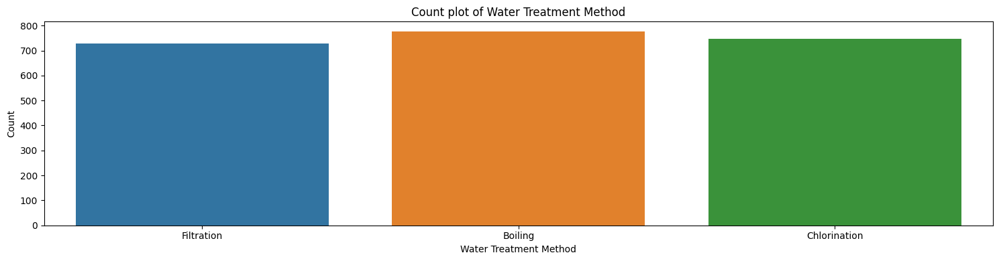

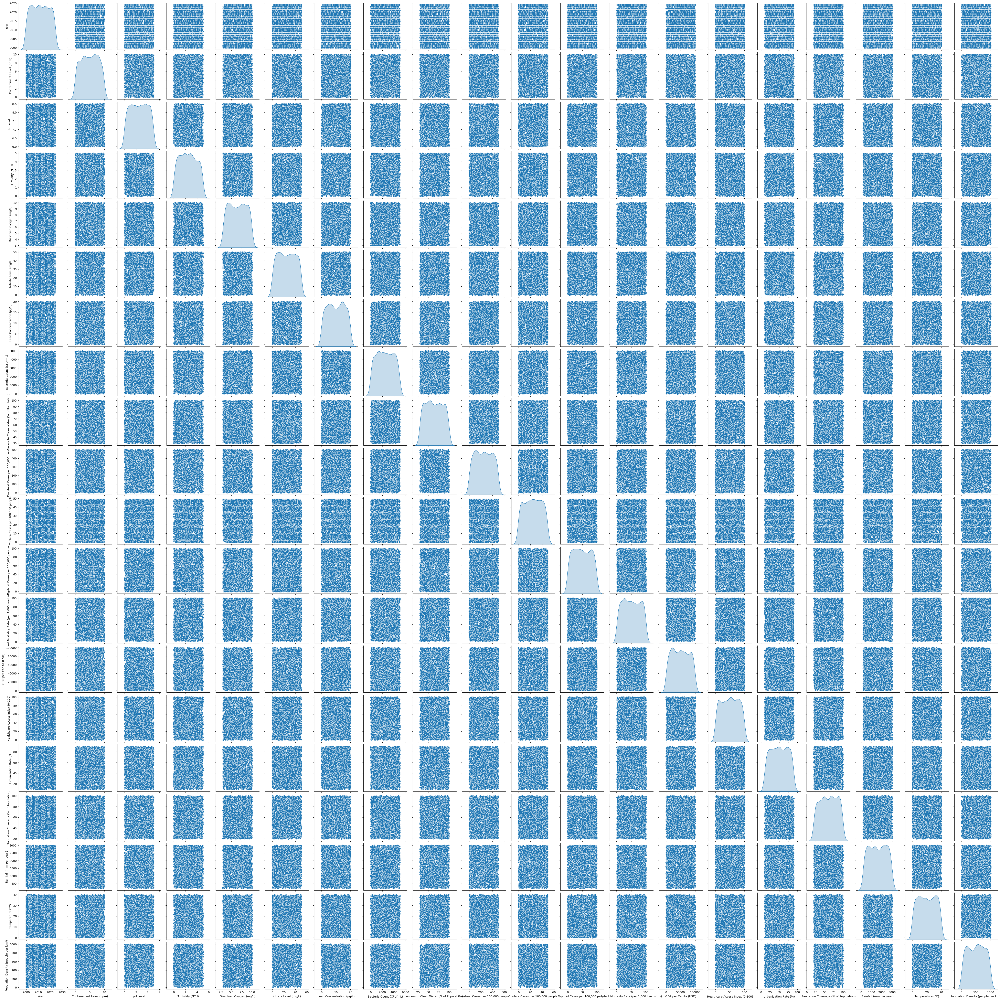

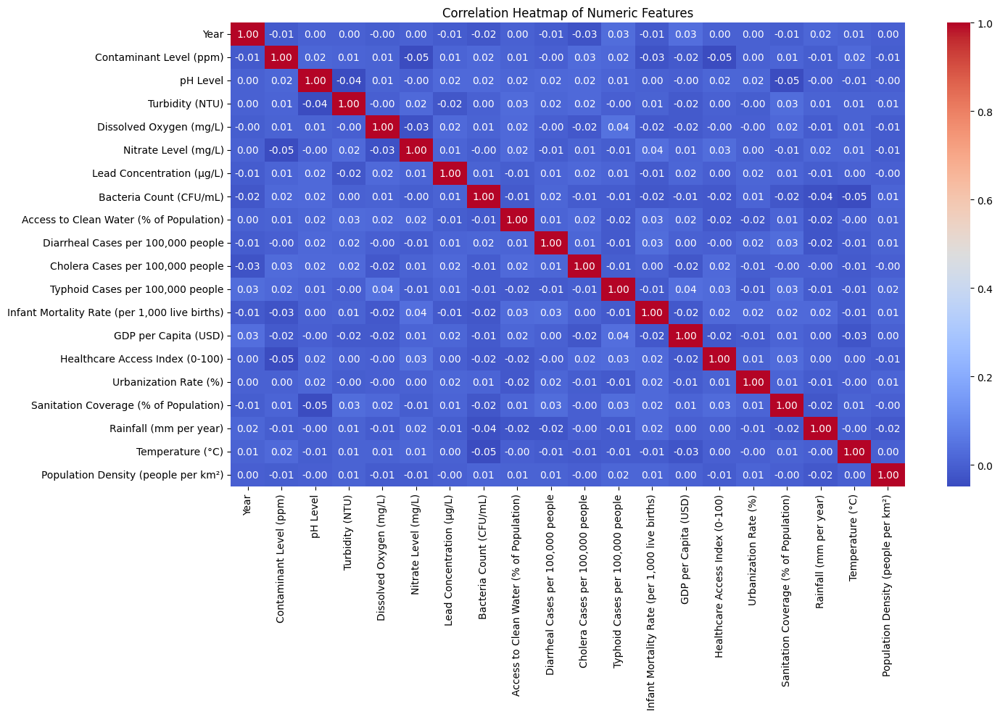

In [10]:
for features in cols:
    if features in df.columns:
        plt.figure(figsize=(15,4))
        sns.histplot(df[features].dropna(),kde=True,color = 'purple')
        plt.title(f'Histogram of {features}')
        plt.xlabel(features)
        plt.ylabel("Count")
        plt.tight_layout()
        plt.show()

for features in char_col:
    if features in df.columns:
        plt.figure(figsize=(15,4))
        sns.countplot(x=features,data=df)
        plt.title(f'Count plot of {features}')
        plt.xlabel(features)
        plt.ylabel("Count")
        plt.tight_layout()
        plt.show()

if set(cols).issubset(df.columns):
    sns.pairplot(df[cols].dropna(),diag_kind='kde')
    plt.show()


numeric_df = df.select_dtypes(include=[np.number])
if numeric_df.shape[1]>=4:
    plt.figure(figsize=(15,10))
    correlation_matrix = numeric_df.corr()
    sns.heatmap(correlation_matrix,annot=True,cmap='coolwarm',fmt='.2f')
    plt.title('Correlation Heatmap of Numeric Features')
    plt.tight_layout()
    plt.show()

# DATA PREPROCESSING

In [11]:
lab_col = ['Country','Region', 'Water Source Type']

In [12]:
df = df.drop(columns=['Water Treatment Method'])

In [13]:
from sklearn.preprocessing import LabelEncoder

In [14]:
le = LabelEncoder()

In [15]:
for column in lab_col:
    df[column] = le.fit_transform(df[column])

In [16]:
df

,Country,Region,Year,Water Source Type,Contaminant Level (ppm),pH Level,Turbidity (NTU),Dissolved Oxygen (mg/L),Nitrate Level (mg/L),Lead Concentration (µg/L),...,"Cholera Cases per 100,000 people","Typhoid Cases per 100,000 people","Infant Mortality Rate (per 1,000 live births)",GDP per Capita (USD),Healthcare Access Index (0-100),Urbanization Rate (%),Sanitation Coverage (% of Population),Rainfall (mm per year),Temperature (°C),Population Density (people per km²)
0,6,2,2015,0,6.06,7.12,3.93,4.28,8.28,7.89,...,33,44,76.16,57057,96.92,84.61,63.23,2800,4.94,593
1,1,4,2017,5,5.24,7.84,4.79,3.86,15.74,14.68,...,27,8,77.30,17220,84.73,73.37,29.12,1572,16.93,234
2,5,0,2022,1,0.24,6.43,0.79,3.42,36.67,9.96,...,39,50,48.45,86022,58.37,72.86,93.56,2074,21.73,57
3,7,1,2016,5,7.91,6.71,1.96,3.12,36.92,6.77,...,33,13,95.66,31166,39.07,71.07,94.25,937,3.79,555
4,6,3,2005,5,0.12,8.16,4.22,9.15,49.35,12.51,...,31,68,58.78,25661,23.03,55.55,69.23,2295,31.44,414
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2995,7,1,2002,4,2.82,7.40,4.43,9.69,37.58,18.52,...,28,56,73.77,21255,75.34,15.22,53.06,264,31.64,882
2996,7,2,2019,0,8.13,8.33,4.77,7.62,38.05,16.98,...,34,34,71.11,79148,6.91,22.89,78.45,2699,33.21,67
2997,9,3,2009,1,1.18,6.76,4.75,7.07,36.13,7.99,...,49,9,96.63,48569,86.17,85.89,47.38,1052,11.57,643
2998,8,3,2009,1,7.56,6.12,3.49,8.93,25.30,19.86,...,33,90,20.71,49099,20.50,20.78,23.34,369,14.69,643


In [17]:
df.describe()

,Country,Region,Year,Water Source Type,Contaminant Level (ppm),pH Level,Turbidity (NTU),Dissolved Oxygen (mg/L),Nitrate Level (mg/L),Lead Concentration (µg/L),...,"Cholera Cases per 100,000 people","Typhoid Cases per 100,000 people","Infant Mortality Rate (per 1,000 live births)",GDP per Capita (USD),Healthcare Access Index (0-100),Urbanization Rate (%),Sanitation Coverage (% of Population),Rainfall (mm per year),Temperature (°C),Population Density (people per km²)
count,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.00000,3000.000000,...,3000.00000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000,3000.000000
mean,4.553333,1.973667,2012.012667,2.538667,4.954390,7.255847,2.480023,6.492850,25.08025,10.047913,...,24.25100,49.270000,50.811900,50036.196667,50.029193,50.062480,60.371007,1591.849000,20.130917,505.390333
std,2.883041,1.417148,7.229287,1.685661,2.860072,0.720464,1.419984,2.027966,14.50517,5.798238,...,14.33259,28.984165,28.465323,28598.750508,28.896676,22.779125,23.159678,817.502434,11.689244,283.275224
min,0.000000,0.000000,2000.000000,0.000000,0.000000,6.000000,0.000000,3.000000,0.05000,0.000000,...,0.00000,0.000000,2.060000,521.000000,0.190000,10.030000,20.010000,200.000000,0.060000,10.000000
25%,2.000000,1.000000,2006.000000,1.000000,2.560000,6.630000,1.257500,4.710000,12.52500,5.120000,...,12.00000,24.000000,26.467500,25010.250000,24.982500,30.557500,40.440000,865.750000,9.840000,254.750000
50%,5.000000,2.000000,2012.000000,3.000000,4.950000,7.280000,2.460000,6.490000,24.79000,10.065000,...,24.00000,49.000000,50.230000,49621.500000,50.390000,49.795000,60.580000,1572.000000,20.175000,513.000000
75%,7.000000,3.000000,2018.000000,4.000000,7.400000,7.870000,3.660000,8.252500,37.91000,15.032500,...,37.00000,75.000000,76.260000,74778.250000,74.817500,69.727500,80.420000,2308.250000,30.672500,745.000000
max,9.000000,4.000000,2024.000000,5.000000,10.000000,8.500000,4.990000,10.000000,49.99000,20.000000,...,49.00000,99.000000,99.990000,99948.000000,99.980000,89.980000,99.990000,2999.000000,39.990000,999.000000


# MODEL LOADING

In [18]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score,r2_score,mean_squared_error,mean_absolute_error

In [19]:
X = df.drop(columns=['pH Level', 'Turbidity (NTU)','Infant Mortality Rate (per 1,000 live births)','Dissolved Oxygen (mg/L)','Typhoid Cases per 100,000 people',
                    'Cholera Cases per 100,000 people','Country', 'Region', 'Year','Water Source Type'])
y = df['pH Level']

In [20]:
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=0.2,random_state=42)

In [21]:
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from xgboost import XGBRegressor

In [22]:
lr = XGBRegressor(n_estimators=20, learning_rate=0.05, max_depth=9,gamma=1, random_state=4)
dt = DecisionTreeRegressor()
rf = RandomForestRegressor()
gb = GradientBoostingRegressor()

In [23]:
lr.fit(X_train,y_train)

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=1, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.05, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=9, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=20, n_jobs=None,
             num_parallel_tree=None, random_state=4, ...)

In [24]:
y_pred_lr = lr.predict(X_test)

In [25]:
mse = mean_squared_error(y_test,y_pred_lr)
mae = mean_absolute_error(y_test,y_pred_lr)
r2 = r2_score(y_test,y_pred_lr)

print(f'mse:{mse:.3f}')
print(f'mse:{mse:.3f}')
print(f'R2:{r2:.3f}')

mse:0.526
mse:0.526
R2:-0.025


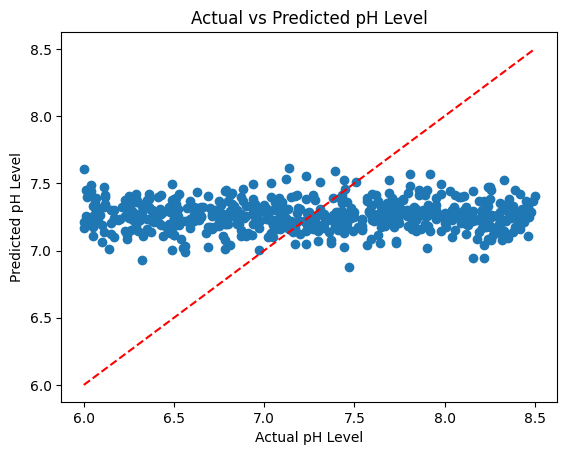

In [26]:
plt.scatter(y_test, y_pred_lr)
plt.xlabel("Actual pH Level")
plt.ylabel("Predicted pH Level")
plt.title("Actual vs Predicted pH Level")
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
plt.show()

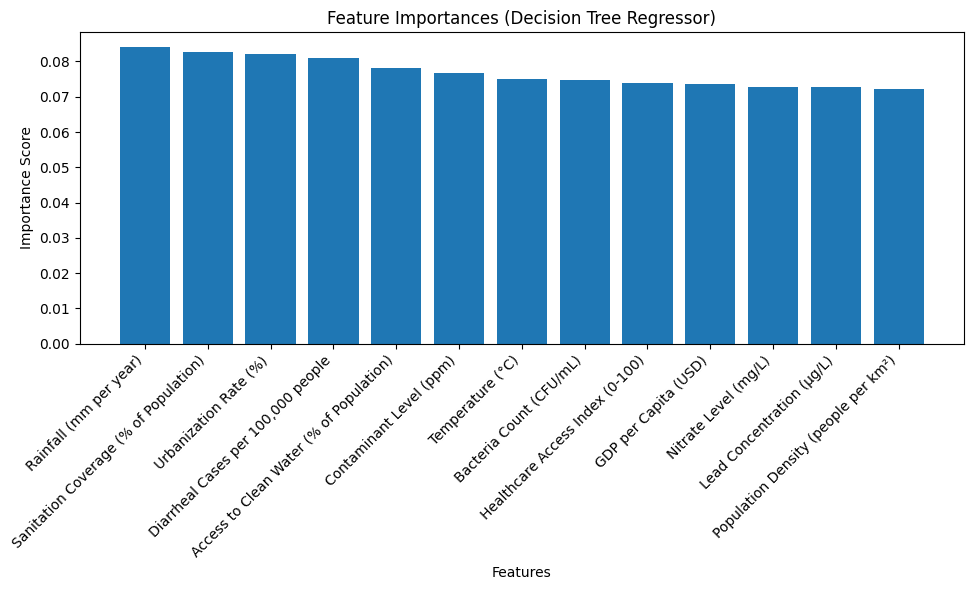

In [27]:
#Get feature importances
importances = lr.feature_importances_
features = X.columns

# Create a bar plot
plt.figure(figsize=(10, 6))
sorted_idx = importances.argsort()[::-1]
plt.bar(range(len(importances)), importances[sorted_idx], align='center')
plt.xticks(range(len(importances)), features[sorted_idx], rotation=45, ha='right')
plt.title("Feature Importances (Decision Tree Regressor)")
plt.xlabel("Features")
plt.ylabel("Importance Score")
plt.tight_layout()
plt.show()

# DecisionTree

In [28]:
dt.fit(X_train,y_train)

DecisionTreeRegressor()

In [29]:
y_pred_dt = dt.predict(X_test)
mse = mean_squared_error(y_test,y_pred_dt)
mae = mean_absolute_error(y_test,y_pred_dt)
r2 = r2_score(y_test,y_pred_dt)

print(f'mse:{mse:.3f}')
print(f'mse:{mse:.3f}')
print(f'R2:{r2:.3f}')

mse:1.101
mse:1.101
R2:-1.146


# RandomForest

In [30]:
rf.fit(X_train,y_train)

RandomForestRegressor()

In [31]:
y_pred_rf = rf.predict(X_test)
mse = mean_squared_error(y_test,y_pred_rf)
mae = mean_absolute_error(y_test,y_pred_rf)
r2 = r2_score(y_test,y_pred_rf)

print(f'mse:{mse:.3f}')
print(f'mse:{mse:.3f}')
print(f'R2:{r2:.3f}')

mse:0.528
mse:0.528
R2:-0.030


# GradientBoosting

In [32]:
gb.fit(X_train,y_train)

GradientBoostingRegressor()

In [33]:
y_pred_gb = gb.predict(X_test)
mse = mean_squared_error(y_test,y_pred_gb)
mae = mean_absolute_error(y_test,y_pred_gb)
r2 = r2_score(y_test,y_pred_gb)

print(f'mse:{mse:.3f}')
print(f'mse:{mse:.3f}')
print(f'R2:{r2:.3f}')

mse:0.540
mse:0.540
R2:-0.052


In [34]:
df.columns

Index(['Country', 'Region', 'Year', 'Water Source Type',
       'Contaminant Level (ppm)', 'pH Level', 'Turbidity (NTU)',
       'Dissolved Oxygen (mg/L)', 'Nitrate Level (mg/L)',
       'Lead Concentration (µg/L)', 'Bacteria Count (CFU/mL)',
       'Access to Clean Water (% of Population)',
       'Diarrheal Cases per 100,000 people',
       'Cholera Cases per 100,000 people', 'Typhoid Cases per 100,000 people',
       'Infant Mortality Rate (per 1,000 live births)', 'GDP per Capita (USD)',
       'Healthcare Access Index (0-100)', 'Urbanization Rate (%)',
       'Sanitation Coverage (% of Population)', 'Rainfall (mm per year)',
       'Temperature (°C)', 'Population Density (people per km²)'],
      dtype='object')

# CONCLUSTION:
> Feature Engineering Required.